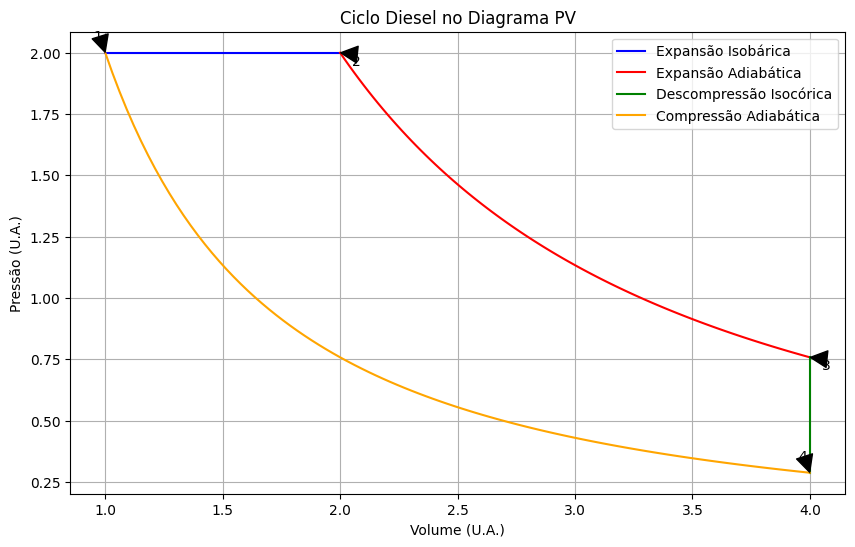

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Valor de gama, o coeficiente de expansão adiabática. Ele exprime a razão entre a capacidade térmica
# a pressão constante (Cp) e a capacidade térmica a volume constante (Cv), para um gás ideal.
# gamma = Cp/Cv = 1.4 para o ar a 20ºC (gás diatômico ideal) .
gamma = 1.4 

# Vamos escolher três valores diferentes de volume de gás para calcular as trajetórias dos processos.
# O ponto 1 = (P1, V1) define o início do ciclo. Os valores e as unidades adotados são arbitrários e
# faremos nR = 1, por simplicidade.
V1 = 1.0
V2 = 2.0
V3 = V4 = 4.0 

# Ponto 1: Início do primeiro processo - expansão isobárica do gás. Vamos usar a equação 
# de estado dos gases ideais: PV = nRT, com nR = 1, por simplicidade. Logo: PV = T.
T1 = 2.0  # Temperatura no Ponto 1 do Diagrama PV.
P1 = T1 / V1  # Pressão no Ponto 1 do Diagrama PV.
# Ponto 2: Final do primeiro processo - expansão isobárica do gás (T1≠T2).
# Temperatura no Ponto 2 do Diagrama PV não é a mesma que a do Ponto 1. 
P2 = P1
T2 = (V2 / V1) * T1      
# Gerando os pontos para a curva que representa a expansão isobárica do gás.
V_exp_isobarica = np.linspace(V1, V2, 100)
P_exp_isobarica = np.linspace(P1, P2, 100)

# Ponto 2: Início do segundo processo - expansão adiabática do gás. 
# No Ponto 2 do ciclo, o volume do gás é V2 e a pressão é P2:
# Ponto 3: Final do segundo processo - expansão adiabática do gás.
# Para um processo adiabático, P*V^gamma = constante, então P3*V3^gamma = P2*V2^gamma. 
# Podemos encontrar o valor da pressão P3 usando os valores dos volumes V2 e V3, conhecendo P2.
P3 = P2 * (V2 / V3) ** gamma
# A temperatura no Ponto 3 é dada pela relação T*V^(gamma-1) = constante (expansão adiabática):
T3 = T2 * (V2 / V3)**(gamma-1)
# Gerando os pontos para a curva que representa a expansão adiabática do gás.
V_exp_adiabatica = np.linspace(V2, V3, 100)
P_exp_adiabatica = P2 * ((V2 / V_exp_adiabatica) ** gamma)

# Ponto 3: Início do terceiro processo: resfriamento isocórico (volume constante) do gás. 
# No Ponto 3 do ciclo, a pressão é P3 e a temperatura é T3. 
# No ponto 4 do ciclo, a temperatura será T4, menor que T3:
T4 = T1 * (V1 / V4)**(gamma-1)
# Para um processo isocórico ou isovolumétrico (com volume constante), P4*T3 = P3*T4.
P4 = P3 * T4 / T3
# Gerando os pontos para a curva que representa a descompressão isocórica do gás.
P_descomp_isocorica = np.linspace(P3, P4, 100)
V_descomp_isocorica = np.linspace(V3, V4, 100)

# Ponto 4: Início do quarto processo - compressão adiabática do gás. 
# No Ponto 1 do ciclo, o volume do gás é V1 e a pressão é P1:
# Ponto 1: Final do quarto processo - compressão adiabática do gás.
# Para um processo adiabático, P*V^gamma = constante, então P3*V3^gamma = P2*V2^gamma. 
# Podemos encontrar o valor da pressão P3 usando os valores dos volumes V2 e V3, conhecendo P2.
P1 = P4 * (V4 / V1) ** gamma
# Gerando os pontos para a curva que representa a expansão adiabática do gás.
V_comp_adiabatica = np.linspace(V4, V1, 100)
P_comp_adiabatica = P4 * ((V4 / V_comp_adiabatica) ** gamma)

# Plotagem do diagrama PV.
plt.figure(figsize = (10, 6))
plt.plot(V_exp_isobarica, P_exp_isobarica, 'b', label = 'Expansão Isobárica')
plt.plot(V_exp_adiabatica, P_exp_adiabatica, 'r', label = 'Expansão Adiabática')
plt.plot(V_descomp_isocorica, P_descomp_isocorica, 'g', label = 'Descompressão Isocórica')
plt.plot(V_comp_adiabatica, P_comp_adiabatica, 'orange', label = 'Compressão Adiabática')
plt.xlabel('Volume (U.A.)')
plt.ylabel('Pressão (U.A.)')
plt.title('Ciclo Diesel no Diagrama PV')
plt.legend()
plt.grid(True)
# Setas indicando os inícios dos processos do ciclo.
plt.annotate('1', xy = (V1, P1), xytext = (V1 - 0.05, P1 + 0.05), arrowprops = dict(facecolor = 'black', shrink = 0.05))
plt.annotate('2', xy = (V2, P2), xytext = (V2 + 0.05, P2 - 0.05), arrowprops = dict(facecolor = 'black', shrink = 0.05))
plt.annotate('3', xy = (V3, P3), xytext = (V3 + 0.05, P3 - 0.05), arrowprops = dict(facecolor = 'black', shrink = 0.05))
plt.annotate('4', xy = (V4, P4), xytext = (V4 - 0.05, P4 + 0.05), arrowprops = dict(facecolor = 'black', shrink = 0.05))
plt.show()

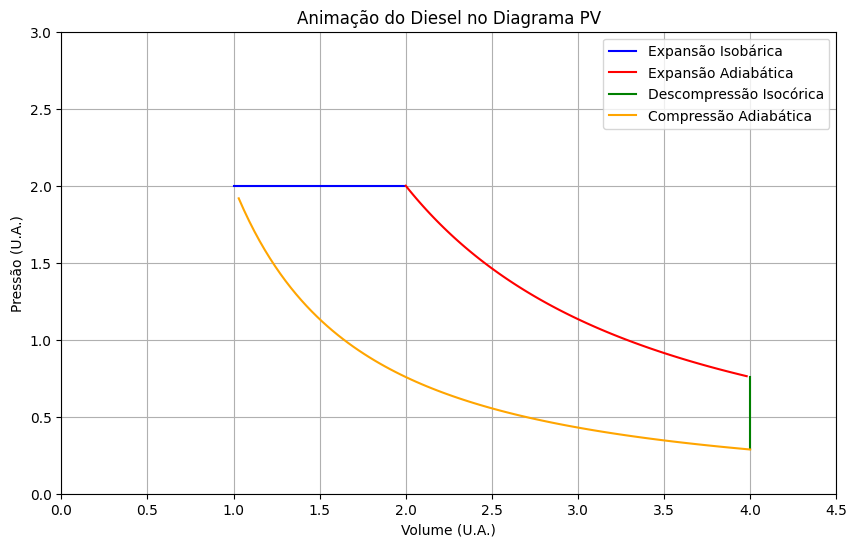

In [2]:
plt.rcParams['animation.embed_limit'] = 256
# Criando a figura e os eixos
fig, ax = plt.subplots(figsize=(10, 6))
ax.set_ylim(0, 3)
ax.set_xlim(0, 4.5)
ax.set_xlabel('Volume (U.A.)')
ax.set_ylabel('Pressão (U.A.)')
ax.set_title('Animação do Diesel no Diagrama PV')

# Inicializando as curvas como linhas vazias
line_exp_isobarica, = ax.plot([], [], 'b', label='Expansão Isobárica')
line_exp_adiabatica, = ax.plot([], [], 'r', label='Expansão Adiabática')
line_descomp_isocorica, = ax.plot([], [], 'g', label='Descompressão Isocórica')
line_comp_adibatica, = ax.plot([], [], 'orange', label='Compressão Adiabática')

# Adicionando a legenda e a grade
ax.legend()
ax.grid(True)

# Função de inicialização, chamada apenas uma vez
def init():
    line_exp_isobarica.set_data([], [])
    line_exp_adiabatica.set_data([], [])
    line_descomp_isocorica.set_data([], [])
    line_comp_adibatica.set_data([], [])
    return line_exp_isobarica, line_exp_adiabatica, line_descomp_isocorica, line_comp_adibatica

# Função de animação
def animate(frame):
    # Atualizando os dados das curvas
    if frame < len(V_exp_isobarica):
        line_exp_isobarica.set_data(V_exp_isobarica[:frame], P_exp_isobarica[:frame])
    elif frame < len(V_exp_isobarica) + len(V_exp_adiabatica):
        line_exp_adiabatica.set_data(V_exp_adiabatica[:frame-len(V_exp_isobarica)], P_exp_adiabatica[:frame-len(V_exp_isobarica)])
    elif frame < len(V_exp_isobarica) + len(V_exp_adiabatica) + len(V_descomp_isocorica):
        line_descomp_isocorica.set_data(V_descomp_isocorica[:frame-(len(V_exp_isobarica)+len(V_exp_adiabatica))], P_descomp_isocorica[:frame-(len(V_exp_isobarica)+len(V_exp_adiabatica))])
    else:
        line_comp_adibatica.set_data(V_comp_adiabatica[:frame-(len(V_exp_isobarica)+len(V_exp_adiabatica)+len(V_descomp_isocorica))], P_comp_adiabatica[:frame-(len(V_exp_isobarica)+len(V_comp_adiabatica)+len(V_descomp_isocorica))])

    return line_exp_isobarica, line_exp_adiabatica, line_descomp_isocorica, line_comp_adibatica

# Configurando a animação
total_frames = len(V_exp_isobarica) + len(V_exp_adiabatica) + len(V_descomp_isocorica) + len(V_comp_adiabatica)
ani = FuncAnimation(fig, animate, frames=total_frames, init_func=init, blit=True, interval=100)

# Exibindo a animação usando JSAnimation
HTML(ani.to_jshtml())
